# Исследование рынка общественного питания Москвы.

Инвесторы фонда решили попробовать себя в новой области и открыть заведение общественного питания в Москве. Заказчики ещё не знают, что это будет за место: кафе, ресторан, пиццерия, паб или бар, — и какими будут расположение, меню и цены.

Необходимо провести исследование московского рынка, найти интересные особенности и презентовать полученные результаты, которые в будущем помогут в выборе подходящего инвесторам места.

Для проведения исследования доступен датасет с заведениями общественного питания Москвы, составленный на основе данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года. Информация, размещённая в сервисе Яндекс Бизнес, могла быть добавлена пользователями или найдена в общедоступных источниках. Она носит исключительно справочный характер.

**Цель исследования:**

- Выявить и презентовать интересные особенности заведений московского общепита.
- Дать рекомендации инвесторам для открытия нового заведения в Москве.

**Ход исследования:**

Исходные данные с информацией о заведениях московского общепита прочитаем из файла `/datasets/moscow_places.csv`. Для проведения исследования необходимо изучить и подготовить данные к анализу. Поэтому сначала проведем предобработку данных: проверим их на наличие пропусков, дубликатов, выбросов и по возможности устраним все обнаруженные проблемы. На этапе иследовательскиого анализа данных рассмотрим и визуализируем с помощью барчартов и пайчартов распределения: заведений, посадочных мест по категориям, соотношение сетевых и несетевых заведений и их распределение по категориям. Выявим топ-15 популярных сетей в Москве. Также в рамках исследовательского анализа изучим распределения: заведений по районам и категориям, средних рейтингов по категориям заведений. Построим фоновые картограммы со средним рейтингом заведений и с медианным числом оценки среднего чека каждого района. В ходе исследования отобразим на карте все заведения общепита. Далее выделим топ-15 улиц по количеству заведений и напротив, улицы с единичным объектом.

На этапе детализации исследования в разрезе кофеен рассмотрим распределение кофеен по административным районам Москвы и исследуем круглосуточные кофейни. Также построим хороплеты со средним рейтингом кофеен и с медианным числом оценки одной чашки капучино каждого района. На основе полученных результатов дадим рекомендацию заказчикам для открытия нового заведения. 

На заключительном этапе зафиксируем полученные результаты в общем выводе исследования и подготовим презентацию исследования для инвесторов.

**Основные этапы исследования:**

1. Знакомство с данными и изучение общей информации.
2. Предобработка данных.
3. Проведение исследовательского анализа данных.
4. Детализация исследования в разрезе кофеен.
5. Составление общего вывода.

## Изучение общей информации из файла с данными.

Ознакомимся с данными сервисов Яндекс Карты и Яндекс Бизнес — датасетом с заведениями общественного питания Москвы на лето 2022 года. Импортируем библиотеки, которые будем использовать для проведения исследовательской работы.

In [1]:
# импорт необходимых библиотек
import pandas as pd
pd.set_option('display.max_colwidth', 0)
import numpy as np
from plotly import graph_objects as go
import plotly.express as px
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt

# импортируем карту, хороплет и маркер
from folium import Map, Choropleth, Marker
# импортируем кластер
from folium.plugins import MarkerCluster
# импортируем собственные иконки
from folium.features import CustomIcon

In [2]:
import warnings
warnings.filterwarnings('ignore')
matplotlib.style.use('ggplot')
%config InlineBackend.figure_format = 'retina'

Для знакомства с исходными данными загрузим информацию о заведениях общественного питания Москвы из CSV-файла в переменную `df`.

In [3]:
# загрузка исходных данных 
try:
    df = pd.read_csv('/datasets/moscow_places.csv')
except:
    df = pd.read_csv('https://code.s3.yandex.net/datasets/moscow_places.csv')

Выведем первые строки датафрейма с московскими общепитами и ознакомимся с описанием представленных данных.

In [4]:
df.head(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


**Описание данных таблицы `df`:**

- `name` — название заведения;
- `address` — адрес заведения;
- `category` — категория заведения, например «кафе», «пиццерия» или «кофейня»;
- `hours` — информация о днях и часах работы;
- `lat` — широта географической точки, в которой находится заведение;
- `lng` — долгота географической точки, в которой находится заведение;
- `rating` — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0);
- `price` — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;
- `avg_bill` — строка, которая хранит среднюю стоимость заказа в виде диапазона, например:

«Средний счёт: 1000–1500 ₽»; «Цена чашки капучино: 130–220 ₽»; «Цена бокала пива: 400–600 ₽» и так далее;
- `middle_avg_bill` — число с оценкой среднего чека, которое указано только для значений из столбца `avg_bill`, начинающихся с подстроки «Средний счёт»:

Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
Если значения нет или оно не начинается с подстроки «Средний счёт», то в столбец ничего не войдёт.
- `middle_coffee_cup` — число с оценкой одной чашки капучино, которое указано только для значений из столбца `avg_bill`, начинающихся с подстроки «Цена одной чашки капучино»:

Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
Если значения нет или оно не начинается с подстроки «Цена одной чашки капучино», то в столбец ничего не войдёт.
- `chain` — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым (для маленьких сетей могут встречаться ошибки):

0 — заведение не является сетевым, 1 — заведение является сетевым
- `district` — административный район, в котором находится заведение (например, Центральный административный округ);
- `seats` — количество посадочных мест.

Ознакомимся с основной информацией датафрейма с московсими общепитами.

In [5]:
# основная информация
df.info() 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


Датасет с информацией о заведениях общественного питания Москвы состоит из 14-и столбцов и 8 406 строк.

Данные представлены в трех типах: `object` ,`float64` и `int`. Названия, адреса, категории, административные районы, режим работы заведений, категории цен и средняя стоимость заказа указаны в текстовом формате. Широта и долгота географических точек, рейтинг заведения, числа с оценками среднего чека и одной чашки капучино, а также количество посадочных мест представлены числами с плавающей точкой. И информация о том, является ли заведение сетевм, представлена целым числом. Типы данных в столбцах корректны.

Приведем названия заведений к нижнему регистру, а затем посчитаем количество строк дубликатов в датасете.

In [6]:
# приведение названий заведений к нижнему регистру
df['name'] = df['name'].str.lower()

print('Количество строк дубликатов:', df.duplicated().sum())

Количество строк дубликатов: 0


Явных строк дубликатов в датасете нет, для надежности дополнительно проверим, нет ли одинаковых пар: названия и адреса заведения.

In [7]:
# количесво дубликатов для пары: название + адрес заведения
print(f"{df.duplicated(subset=['name', 'address']).sum()} заведения и адреса дублируются.")
print("{0:.2%}".format(df.duplicated(subset=['name', 'address']).sum() / len(df)), 'дубликатов пар названия и адреса заведения.')

3 заведения и адреса дублируются.
0.04% дубликатов пар названия и адреса заведения.


С учетом незначительного масштаба бедствия, очистим данные от дубликатов и определим количество уникальных пар названия и адреса заведения.

In [8]:
# удаление строк с дубликатами пар: название + адрес заведения
df = df.drop_duplicates(subset=['name', 'address'])

# количество уникальных пар: название, адрес заведения
df.groupby(['name', 'address']).ngroups

8403

Таким образом, в данных о заведениях общественного питания Москвы представлены 8 403 уникальных пары названия и адреса заведения. Также рассчитаем число уникальных заведений московского общепита.

In [9]:
# количество уникальных заведений
print(df.name.nunique(), 'уникальных заведений представлены в данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года.')

5512 уникальных заведений представлены в данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года.


На заключительном этапе знакомства с данными проверим их на наличие пропусков.

In [10]:
print('Количество пропущенных значений:')
print(df.isna().sum())

Количество пропущенных значений:
name                 0   
category             0   
address              0   
district             0   
hours                535 
lat                  0   
lng                  0   
rating               0   
price                5088
avg_bill             4587
middle_avg_bill      5254
middle_coffee_cup    7868
chain                0   
seats                3611
dtype: int64


В столбцах с режимом работы, категорией цен, средней стоимостью заказа в виде диапазона, числами с оценкой среднего чека и одной чашки капучино, а также в данных с количеством посадочных мест имеются пропущенные значения. Чтобы понимать масштаб пропусков, отразим процент пропущенных значений по каждому показателю.

In [11]:
# % количества пропусков от общего числа показателей по каждому столбцу с округлением до 2-х знаков
pd.DataFrame(round(df.isna().mean()*100, 2)).sort_values(by=0).style.format('{:.2f}') \
.background_gradient('coolwarm')

,0
name,0.00
category,0.00
address,0.00
district,0.00
lat,0.00
lng,0.00
rating,0.00
chain,0.00
hours,6.37
seats,42.97


Порядка 6 % данных не содержат информации о режиме работы заведения, процент пропущенных значений в 5-ти других столбцах внушительный. Поэтому не можем избавиться от такого количества строк, т.к. результаты исследования могут сильно исказиться. 

**Вывод:**

На этапе знакомства с данными изучили общую информацию о заведениях общественного питания Москвы на лето 2022 года. В датасете присутствовало незначительное число строк дубликатов, от которых мы избавились перед анализом. Появление дублированных строк, вероятно, обусловлено какими-либо технологическими факторами, к примеру, техническим сбоем при загрузке или выгрузке данных. В процессе проверки типов данных на соответствие сохранённым в них значениям, убедились в корректности типов в каждом столбце. Выяснили, что в данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года представлены 8 403 заведения московского общепита, из которых 5 512 уникальные. В ходе ознакомления с данными обнаружили пропущенные значения в 6-ти столбцах, изучением и обработкой которых займемся на следующем этапе предобработки данных. Таким образом, этап изучения общей информации заверешен, приступаем к подготовке данных для анализа. 

## Предобработка данных.

На этапе знакомства с датасетом мы обнаружили и очистили данные от незначительного количества явных дубликатов. Проверим названия заведений на наличие неявных дубликатов.

In [12]:
# уникальные названия заведений и их количество
display(df.name.unique())
display(df.name.value_counts())

array(['wowфли', 'четыре комнаты', 'хазри', ..., 'миславнес', 'самовар',
       'kebab time'], dtype=object)

кафе                189
шоколадница         120
домино'с пицца      77 
додо пицца          74 
one price coffee    72 
                    .. 
ах... плов          1  
прошу к столу       1  
кофе-порт           1  
сметана             1  
kebab time          1  
Name: name, Length: 5512, dtype: int64

Неявных дубликатов в названиях не обнаружили, также ознакомимся с категорями заведений.

In [13]:
# уникальные названия категории заведений и их количество
display(df.category.unique())
display(df.category.value_counts())

array(['кафе', 'ресторан', 'кофейня', 'пиццерия', 'бар,паб',
       'быстрое питание', 'булочная', 'столовая'], dtype=object)

кафе               2377
ресторан           2042
кофейня            1413
бар,паб            764 
пиццерия           633 
быстрое питание    603 
столовая           315 
булочная           256 
Name: category, dtype: int64

Категории заведений также уникальны, неявных дубликатов нет. 

На этапе изучения общей информации мы обнаружили пропущенные значения в 6-ти столбцах. Меньше всего пропусков (порядка 6 %) в столбце с режимом работы заведений, не будем удалять эти завдения и оставим поле незаполненным, т.к. режим работы заведений может быть различным. Почти 43 % пропусков в количестве посадочных мест, также не можем найти логичную замену, данный показатель может сильно варьироваться даже внутри одной сети заведений. Более чем у половины заведений не указана средняя стоимость заказа в виде диапазона, категория цен в заведении, а также число с оценкой среднего чека. Посмотрим на средний счет заведений в разрезе категорий цен, если разброс среднего чека внутри категории будет небольшим, сможем заполнить часть пропусков ценовой категории заведений.

In [14]:
# Средние чеки заведений в разрезе ценовых категорий
print(df[df.avg_bill.apply(lambda x: 'счёт' in str(x))].groupby('price')['avg_bill'].unique())

price
высокие          [Средний счёт:1500–2000 ₽, Средний счёт:2000–2500 ₽, Средний счёт:2100 ₽, Средний счёт:2000 ₽, Средний счёт:1500–3000 ₽, Средний счёт:2500–3000 ₽, Средний счёт:2000–3000 ₽, Средний счёт:4500–5500 ₽, Средний счёт:2500 ₽, Средний счёт:1500–5000 ₽, Средний счёт:1500–2500 ₽, Средний счёт:1500–1880 ₽, Средний счёт:5000–17000 ₽, Средний счёт:3500–4000 ₽, Средний счёт:от 2000 ₽, Средний счёт:от 1800 ₽, Средний счёт:1800 ₽, Средний счёт:3000 ₽, Средний счёт:4000–5000 ₽, Средний счёт:700–3000 ₽, Средний счёт:800–3000 ₽, Средний счёт:1400 ₽, Средний счёт:900–1000 ₽, Средний счёт:3500–5000 ₽, Средний счёт:1300–2500 ₽, Средний счёт:2000–3500 ₽, Средний счёт:от 2500 ₽, Средний счёт:3000–4000 ₽, Средний счёт:2500–3500 ₽, Средний счёт:3000–3500 ₽, Средний счёт:1200–3000 ₽, Средний счёт:2500–4000 ₽, Средний счёт:1000–2500 ₽, Средний счёт:1500–1800 ₽, Средний счёт:700–3500 ₽, Средний счёт:500–3000 ₽, Средний счёт:1800–2500 ₽, Средний счёт:1000–10000 ₽, Средний счёт:5000–5500 ₽, С

Видим, что внутри каждой ценовой категории очень большой разброс значений, поэтому на основе среднего чека не удастся заполнить пропуски категории цен заведения. Это некритично, эти данные не будут рассматриваться при анализе, поэтому пропуски ценовой категории не повлияют на результаты исследования.

Числа с оценкой среднего чека - `middle_avg_bill` и оценкой одной чашки капучино - `middle_coffee_cup` заполняются на основе средней стоимости заказа в `avg_bill`. Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений. Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число. Если значения нет или оно не начинается с подстроки «Средний счёт», то в столбец ничего не войдёт. С учетом того, что у большинства заведений неизвестна стоимость среднего заказа, заполнить пропуски в числах с оценками среднего чека и одной чашки капучино также не получится, поэтому оставим данные без изменений.

Посмотрим на распределение значений всех числовых столбцов таблицы.

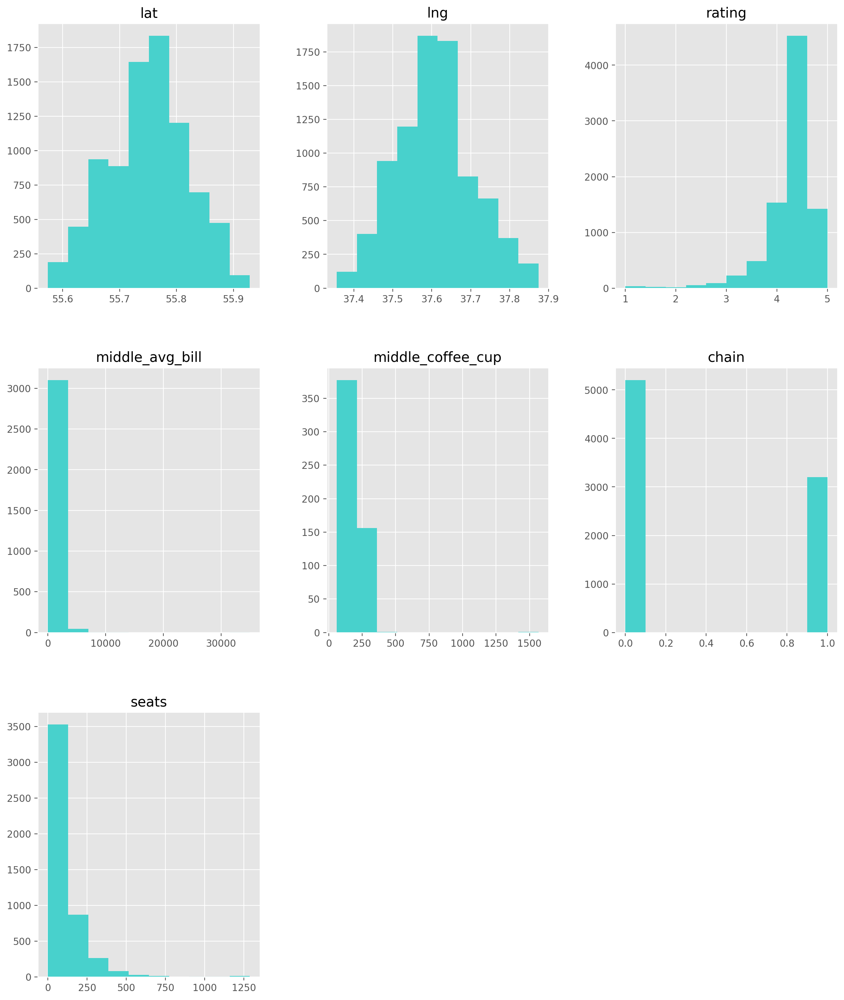

In [15]:
# гистограммы по всем числовым столбцам
df.hist(color='mediumturquoise', figsize=(15, 18));

Рейтинг заведений, как и положено, варьируется от 1 до 5. Число с оценкой среднего чека для большинства заведений не превышает 5 000 р., число с оценкой одной чашки капучино большинства заведений в пределах 250 р. А вот количество посадочных мест вызывает вопросы, у большей части заведений менее 250 мест, но встречаются и такие, где мест больше 1000. Для более детального исследования выведем статистические показатели столбца `seats`.

In [16]:
# статистические показатели по количеству мест
df.seats.describe()

count    4792.000000
mean     108.361436 
std      122.841130 
min      0.000000   
25%      40.000000  
50%      75.000000  
75%      140.000000 
max      1288.000000
Name: seats, dtype: float64

Видим, что максимальное количество мест - 1 288, а средний показатель в 108 мест значительно превышает медиану - 75, что подтверждает наличие выбивающихся знаений. 

Для определения границы аномальных значений посчитаем 99-й перцентиль количества посадочных мест.

In [17]:
# расчет 95-го и 99-го перцентелей количества посадочных мест
print('99-й перцентиль количества посадочных мест: {}'.format(np.nanpercentile(df['seats'], 99)))

99-й перцентиль количества посадочных мест: 625.0


Не более, чем у 1% заведений количество посадочных мест превышает 625. Проверим, как много заведений превышают данное значение.

In [18]:
# расчет абсолютного и относительного показателей заведений с большим количеством мест
print(f"У {df[df['seats'] > 625]['name'].count()} заведений количество посадочных мест более 625 штук.")
print("{0:.2%}".format(df[df['seats'] > 625]['name'].count() / len(df)), 'заведений имеют аномальное количество мест.')

У 30 заведений количество посадочных мест более 625 штук.
0.36% заведений имеют аномальное количество мест.


Масштаб потерь при фильтрации будет незначительным, поэтому очистим данные от заведений с неправдоподобными значениями.

In [19]:
# фильтрация заведений с количеством мест более 625
df_filtered = df[df['seats'] > 625]
df = df.query('index not in @df_filtered.index')

На этапе подгтовки данных к анализу создадим столбец `street` с названиями улиц из столбца с адресом.

In [20]:
# добавление столбца с улицей
df['street'] = df['address'].str.split(', ').str[1]

Также добавим столбец `is_24/7` с обозначением, что заведение работает ежедневно и круглосуточно (24/7):

- логическое значение `True` — если заведение работает ежедневно и круглосуточно;
- логическое значение `False` — в противоположном случае.

In [21]:
# добавление столбца с указанием на ежедневность и круглосуточность
df['is_24/7'] = df.hours.str.contains('ежедневно, круглосуточно')

Посмотрим на первые строки обновленной таблицы, чтобы взглянуть на новые столбцы.

In [22]:
df.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,wowфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,улица Дыбенко,False
1,четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица Дыбенко,False
2,хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,Клязьминская улица,False
3,dormouse coffee shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица Маршала Федоренко,False
4,иль марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,Правобережная улица,False


**Вывод:**

Таким образом, этап предобработки данных завершен. Неявных дубликатов в датасете с московскими заведениями общественного питания не обнаружили. Пропущенные значения найдены, изучены, но не обработаны в виду отсутствия логической замены. Режим работы и количество посадочных мест могут сильно варьироваться от заведения к заведению, а числа с оценкой среднего чека и одной чашки капучино заполняются на основе средней стоимости заказа, которая неизвестна для большинства заведений. В ходе исследования рассмотрели распределения значений числовых столбцов и обнаружили заведения с аномально большим количеством посадочных мест. В силу незначительных потерь отфильтровали данные с выбивающимися значениями. Также для удобства дальнейшего анализа дополнили исходный датасет двумя столбцами, где в одном указали названия улиц, а в другом подсветили заведения, работающие ежедневно и круглосуточно.

## Анализ данных.

- **Распределение заведений по категориям.**

Посмотрим, какие категории заведений представлены в данных.

In [23]:
# уникальные названия категории заведений и их количество
category_cnt = df.category.value_counts()
print(category_cnt)

кафе               2369
ресторан           2035
кофейня            1408
бар,паб            757 
пиццерия           632 
быстрое питание    602 
столовая           314 
булочная           256 
Name: category, dtype: int64


Наиболее распространены кафе и рестораны, для более удобного исследования распределения заведений по категориям визуализируем количество объектов общественного питания по категориям с помощью столбчатой диаграммы.

In [24]:
# построение столбчатой диаграммы распределения заведений по категориям
fig = go.Figure(data=[go.Bar(x=category_cnt.index, y=category_cnt, marker = {'color': 'mediumorchid', 'opacity': 0.7},
      text= category_cnt, textposition='outside')])
fig.update_layout(title={'text':'Распределение заведений по категориям','x':0.5}, 
                  xaxis_title='Категория заведения', yaxis_title='Количество заведений', width=900, height=500)
fig.show();

Также построим круговую диаграмму для визуализации соотношения видов объектов общественного питания по количеству.

In [25]:
# построение круговой диаграммы
colors = ['B983FF', 'D9ACF5','94B3FD','94DAFF', '99FEFF', '98EECC', 'D0F5BE', 'FBFFDC', 'FBD6D2']
fig = go.Figure(data=[go.Pie(labels=category_cnt.index, values=category_cnt, marker={'colors':colors})])
fig.update_layout(title={'text':'Соотношение видов объектов общественного питания по количеству','x':0.5}, legend=dict(x=0.8)) 
fig.show()

В датасете представлены 8 категорий заведений. В топ-3 входят: кафе, рестораны и кофейни, а меньше всего столовых и булочных.
2363 кафе составляют порядка 28 % от всех заведений, ресторанов чуть меньше - 2030, доля которых примерно 24 %, и 1401 кофейня занимает почти 17 % ниши московского общепита. 9 % завдений представлены барами и пабами, чуть меньше пиццерий и заведений быстрого питания. Около 4 % составляют столовые и наименьшая доля в районе 3 % приходится на булочные. 

- **Распределение посадочных мест в заведениях по категориям.**

Для исследования распределения количества посадочных мест в заведениях в разрезе их категорий, проверим сильно ли отличаются средние показатели от медианных. Для этого выведем статистические характеристики количества мест в различных категориях общепита.

In [26]:
# статистические показатели кол-ва мест в разрезе по категориям заведений
display(df.groupby('category')['seats'].describe())

,count,mean,std,min,25%,50%,75%,max
category,,,,,,,,
"бар,паб",460.0,112.228261,101.430112,0.0,47.75,80.0,140.00,625.0
булочная,148.0,89.385135,97.685844,0.0,25.00,50.0,120.00,625.0
быстрое питание,348.0,96.186782,94.016352,0.0,27.25,65.0,136.25,500.0
кафе,1209.0,92.021505,95.968406,0.0,35.00,60.0,114.00,625.0
кофейня,746.0,105.355228,103.744594,0.0,40.00,80.0,143.75,625.0
пиццерия,426.0,91.694836,96.320059,0.0,30.00,53.5,120.00,625.0
ресторан,1262.0,116.925515,101.938775,0.0,48.00,86.0,150.00,625.0
столовая,163.0,93.000000,87.704048,0.0,40.00,75.0,116.00,625.0


Для всех видов заведений средние значения количества посадочных мест превышают медиану, это обусловлено ненормальным распределением данных, а также наличием выбивающихся значений. В целом иерархия категорий заведений по количеству мест не меняется в зависимости от оценки по среднему и медианному показателю, но чтобы нивелировать воздействие выбивающихся показателей будем анализировать данные по медианным значениям.

Посмотрим, сколько посадочных мест в заведениях общепита Москвы в разрезе по категорям. Для этого визуализируем данные с помощью боксплота и столбчатой диаграммы, на которой для каждой категории заведений отразим медианные значения количества посадочных мест.

In [27]:
# Медиана количества мест по категориям заведений
seats_cnt = df.groupby('category')['seats'].median().sort_values(ascending=False)

# построение столбчатой диаграммы распределения заведений по категориям
fig = go.Figure(data=[go.Bar(x= seats_cnt.index, y= seats_cnt, marker = {'color': 'mediumorchid', 'opacity': 0.7}, 
      text= seats_cnt, textposition='outside')])
fig.update_layout(title={'text':'Распределение количества посадочных мест по заведениям','x':0.5},
                  xaxis_title='Категория заведения', yaxis_title='Количество посадочных мест', width=900, height=500)
fig.show();

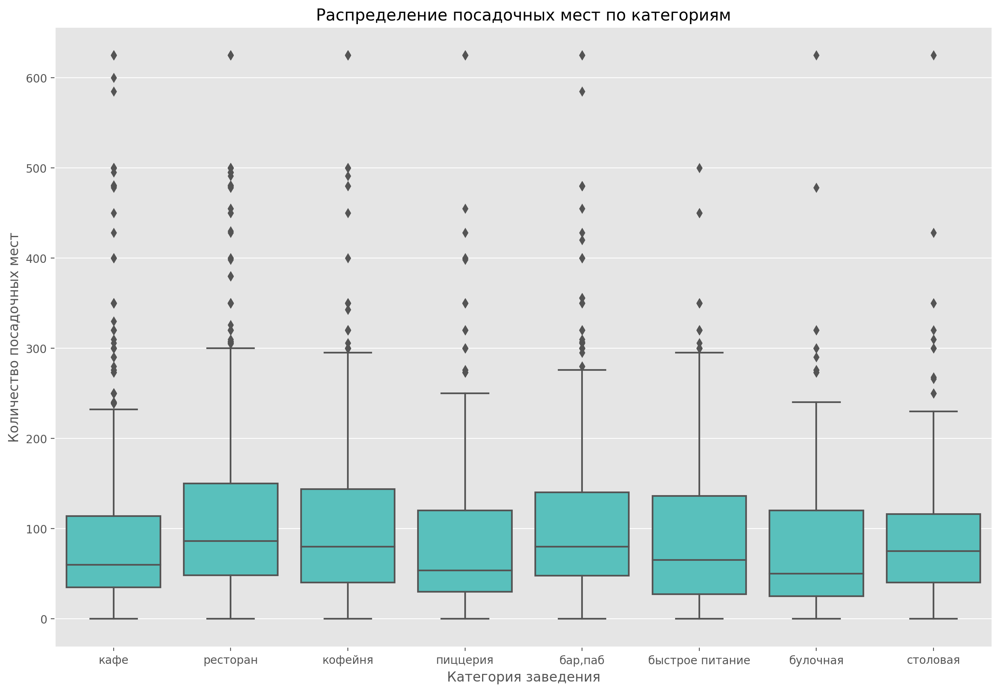

In [28]:
# ящик с усами с количеством мест по категориям заведений
plt.figure(figsize=(15,10))
sns.boxplot(data=df, x='category', y='seats', color='mediumturquoise')
plt.xlabel('Категория заведения')
plt.ylabel('Количество посадочных мест')
plt.title('Распределение посадочных мест по категориям');

На диаграмме размаха видим, что среди каждой категории заведений встречаются выбивающие значения. Наименьшее число выбросов по количеству посадочных мест у булочных и заведений быстрого питания, а максимальное количество отклоняющихся значений у кафе. 

Таким образом, наименьшее количество мест в булочных и пиццериях - 50 и 54 по медианным показателям. Немногим больше в кафе и заведениях быстрого питания - 60 и 65 посадочных мест. В столовых, кофейнях и барах  могут расположиться от 75 до 80 клиентов. И наиболее вместительными являются рестораны, где резмещаются порядка 86 гостей, ориентируюясь на медианные значения. 

- **Соотношение сетевых и несетевых заведений.**

Рассмотритм и изобразим соотношение сетевых и несетевых заведений в датасете. Определим, каких заведений больше.

In [29]:
# количество сетевых и несетвых заведений
print(df.chain.value_counts())

0    5181
1    3192
Name: chain, dtype: int64


3 177 заведений являются сетевыми, но большинство заведений - 5 170 несетевые. Визуализируем соотношение сетевых и несетевых заведений с помощью круговой диаграммы.

In [30]:
# построение круговой диаграммы соотношения сетевых и несетевых заведений
fig = go.Figure(data=[go.Pie(labels=['несетевые', 'сетевые'], values=df.chain.value_counts(), 
                marker={'colors':['D9ACF5','94DAFF']})])
fig.update_layout(title={'text':'Соотношение сетевых и несетевых заведений','x':0.5}, legend=dict(x=0.8)) 
fig.show()

Большая часть заведений московского общепита не являются сетевыми, порядка 62 %. Соответсвенно 38 % заведений - сетевые. Определим, какие категории заведений чаще являются сетевыми. Посмотрим на распределение количества сетевых и несетквых заведений по их категориям, и определим, какие категории заведений чаще являются сетевыми.

In [31]:
chain_cnt = df[df['chain'] == 1].groupby(['category'])['name'].count().reset_index().sort_values(by='name', ascending=False)
no_chain_cnt = df[df['chain'] == 0].groupby(['category'])['name'].count().reset_index().sort_values(by='name', ascending=False)

# столбчатая диаграмма распределения сетевых и несетевых заведений по категориям
fig = go.Figure()
fig.add_trace(go.Bar(x=chain_cnt.category, y=chain_cnt.name, text=chain_cnt.name, textposition='outside', \
                     name='cетевые', marker={'color': 'lightskyblue', 'opacity': 0.9}))
fig.add_trace(go.Bar(x=no_chain_cnt.category, y=no_chain_cnt.name, text=no_chain_cnt.name, textposition='outside', \
                     name='несетевые', marker={'color': 'mediumorchid', 'opacity': 0.9}))
# добавление названий графика и осей
fig.update_layout(title={'text':'Распределение сетевых и несетевых заведений по категориям','x':0.5},\
                  xaxis_title='Категория заведения', yaxis_title='Количество заведений', legend=dict(y=0.96, x=0.85))
fig.show()

Распределение количества заведений по категорям в разрезе сетевых и несетевых немного отличается. Среди несетевых общепитов больше ресторанов и кафе, также значительная доля приходится на бары и кофейни. Реже сегмент представлен заведениями быстрого питания и пиццерий. Меньше всего в несетевом сегмете столовых и булочных.

Значительная часть сетевых заведений приходится на кофейни, рестораны и кафе. В меньшем количестве встречаются заведения быстрого питания и пиццерии. Минимальное количество заведений в сетевом сегменте у булочных и столовых.

Отметим, что при сравнении количества заведений каждой категории в разрезе сети и несетевого сегмента количество сетевых объектов у кофеен, пиццерий и булочных превосходит несетевой сегмент, чего нельзя сказать о кафе, ресторанах, заведениях быстрого питания, барах и столовых.

- **Топ-15 популярных сетей в Москве.**

Чтобы выбрать 15 самых широких сетей московского общепита, соберем датафрейм для самых популярных сетевых заведений. С помощью горизонтальной столбчатой диаграммы отобразим топ-15 сетей с количеством их заведений в Москве.

In [32]:
# датафрейм для топ-15 популярных сетей
chain_15 = df.query('chain == 1').groupby(['name'], as_index=False).agg({'address':'count'})\
.sort_values(by='address', ascending = False).head(15)

# построение барчарта распределения популярных сетей
fig = px.bar(chain_15.sort_values(by='address'), x='address', y='name',
             text='address', color_discrete_sequence=['mediumorchid'], opacity= 0.6)
fig.update_layout(title={'text':'Топ-15 сетевых заведений московского общепита','x':0.5},
                  xaxis_title='Количество заведений', yaxis_title='Название сети')
fig.show()  

Самой распространенной сетью является известная «Шоколадница» - 118 кофеен в Москве. Широко распространены пиццерии «Домино'с пицца» и «ДоДо пицца», а также кофейни «One price coffee» и «Cofix». «Яндекс лавка» имеет 68 точек и занимает 5-е место в рейтинге популярных сетей московского общепита. Замыкает топ-15 сеть кафе «Му-му», представленная 27-ю заведениями.

Отобразим категории заведений популярных сетей общепита в Москве.

In [33]:
# категории популярных сетей
display(pd.DataFrame(df.query('name in @chain_15.name').groupby('name')['category'].unique()))

,category
name,
cofefest,"[кофейня, кафе]"
cofix,[кофейня]
one price coffee,[кофейня]
prime,"[ресторан, кафе]"
буханка,"[булочная, кофейня, кафе]"
додо пицца,[пиццерия]
домино'с пицца,[пиццерия]
кофепорт,[кофейня]
кулинарная лавка братьев караваевых,[кафе]


В целом в топе много заведений, ориентированных на невысокий средний чек и большую проходимость. Подтверждаются выводы, сделанные во время исследования распределения сетевых заведений по категорям, значительная часть популярных сетей общепита в Москве приходится на кафе и кофейни. Отметим, что Яндекс.Лавка не является рестораном, это онлайн-магазин, в котором можно заказать продукты или другие товары. Также подозрительные заведения в топе Хинкальная, не критично, но вероятнее это не сеть, а просто название заведений определенного вида.

- **Распределение заведений по районам и категориям.**

Выведем названия всех административных районов Москвы, представленных в датасете.

In [34]:
print('В датасете представлено', len(df.district.unique()), 'районов:', ', '.join(df.district.unique()))

В датасете представлено 9 районов: Северный административный округ, Северо-Восточный административный округ, Северо-Западный административный округ, Западный административный округ, Центральный административный округ, Восточный административный округ, Юго-Восточный административный округ, Южный административный округ, Юго-Западный административный округ


Определим наиболее популярные районы по распределению заведений общепита и визуализируем количество точек московского общепита по административным районам с помощью горизонтального барчарта.

In [35]:
# датафрейм с количеством заведений по районам
df_distr = df.groupby(by='district', as_index=False)['name'].count().sort_values(by='name')

# построение барчарта распределения популярных сетей
fig = px.bar(df_distr, x='name', y='district',
             text='name', color_discrete_sequence=['mediumorchid'], opacity= 0.6)
fig.update_layout(title={'text':'Распределение заведений московского общепита по административным районам','x':0.5},
                  xaxis_title='Количество заведений', yaxis_title='Административный район')
fig.show()  

Неудивительно, что наибольшее количество объектов общепита в Москве сосредоточено в Центральном административном округе - 2242 заведения. В других административных округах от 700 до 900 точек общственного питания. Наименьшее число объектов в Северо-Западном АО - 409 точек. Чтобы проанализовать соотношение районов по количеству объектов общественного питания построим пайчарт.

In [36]:
# построение круговой диаграммы соотношения районов по количеству заведений
fig = go.Figure(data=[go.Pie(labels=df_distr.district, values=df_distr.name, marker={'colors':colors})])
fig.update_layout(title={'text':'Соотношение районов по количеству объектов общественного питания','x':0.5}, legend=dict(x=0.8)) 
fig.show()

Круговая диаграмма отражает, что в ЦАО Москвы расположены порядка 27% заведений общепита. В остальных районах изменения незначительные, в них сосредоточены от 8,5% до 11% обеъктов, за исключением СЗАО, на долю которого приходится около 5% заведений.

Далее исследуем распределение заведений каждой категории по районам. Воспользуемся барчартом и отобразим количество заведений в каждом районе в разрезе категорий объектов московского общепита.

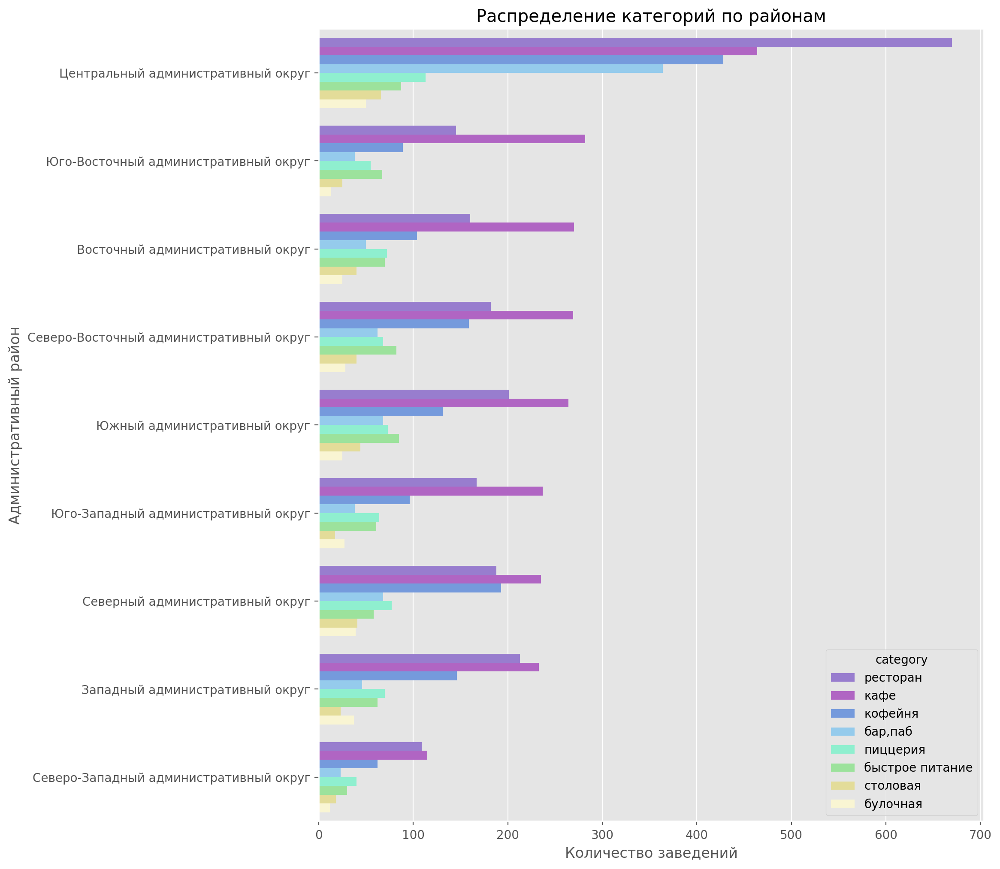

In [37]:
# датафрейм с количеством заведений по районам и категориям
df_district = df.groupby(['district', 'category'], as_index=False)['address'].count()

# построение барчарта распределения заведений по районам и категориям
colors_bar=['mediumpurple','mediumorchid','cornflowerblue','lightskyblue', 'aquamarine', 'lightgreen', 'khaki', 'lemonchiffon']
plt.figure(figsize=(10, 12))
ax = sns.barplot(y='district', x='address', hue='category', data=df_district.sort_values(by='address', ascending=False), \
            palette=colors_bar)

ax.set_xlabel('Количество заведений'), ax.set_ylabel('Административный район')
plt.title('Распределение категорий по районам');

Большая часть ресторанов сосредоточена в ЦАО, в остальных районах наиболее популярны кафе. Также в них много ресторанов и кофеен. В разрезе по районам булочные и столовые также менее распространены. В целом распределение категорий заведений по районам (без учета ЦАО) схожее. В ЦАО в отличие от других районов довольно популярны пабы и бары.

Объединим общее распределение количества заведений по районам с распределением объектов каждой категории по районам и проиллюстрируем эту информацию одним графиком.

In [38]:
# график общего распределения заведений по районам и в разрезе по категориям
fig = px.bar(df_district.sort_values(by='address', ascending=True), x='district', y='address', color='category',
             color_discrete_sequence=colors_bar, text='address')

fig.update_layout(xaxis={'categoryorder':'total descending'}, width=1000, height=800, 
                  title={'text':'Распределение заведений по административным районам и категориям','x':0.45}, 
                  xaxis_title='Административный район', yaxis_title='Количество заведений', legend=dict(y=0.96, x=0.75))
fig.show() 

Таким образом, резюмируем, что наибольшее количество объектов ощепита сосредоточено в ЦАО, а наименьшее в СЗАО Москвы. Распределение категорий заведений во всех районах, кроме Центрального окурга схожее. Наиболее распространены кафе - от 231 до 282 штук (115 в СЗАО), также популярны рестораны - от 145 до 213 точек (109 в СЗАО). На третьем месте по популярности кофейни, следом идут пиццерии - от 55 до 74 точек (40 в СЗАО). Схожая доля объектов приходится на заведения быстрого питания, чуть меньше пабов и баров. Меньше всего в каждом районе столовых и булочных. Распределение категорий объектов общепита в ЦАО отличается тем, что в нем наибольшая концентрация ресторанов - 670 объектов, а также, помимо кафе и кофеен, достаточно много баров и пабов - 364 точки.

- **Распределение средних рейтингов по категориям заведений.**

Проверим, различаются ли усреднённые рейтинги в разных типах общепита. Посторим барчарт с распределением средних рейтингов по категориям заведений.

In [39]:
# средние рейтинги по каждой категории заведения
df_rating = round(df.groupby('category')['rating'].mean().sort_values(ascending=False), 2)

# построение барчарта с распределением средних рейтингов по категориям заведений
fig = px.bar(df_rating.sort_values(), x=df_rating.index, y=df_rating, text=df_rating, color_discrete_sequence=['mediumorchid'],\
            opacity= 0.6)
fig.update_yaxes(range=[3.5, 5])
fig.update_layout(title={'text':'Распределение средних рейтингов по категориям заведений','x':0.5},
                  xaxis_title='Категория заведения', yaxis_title='Средний рейтинг по оценкам пользователей',
                  width=1000, height=700, legend=dict(y=0.99, x=0.8))
fig.show() 

Усреднённые рейтинги заведений по оценкам пользователей в Яндекс Картах в разных типах общепита незначительно отличаются, они находятся в диапазоне от 4.05 - у заведений быстрого питания до 4.39 - у баров и пабов. На втором и третьем местах по средним оценкам пользователей - пиццерии и рестораны.

Проверим рейтинги по категориям заведений на чувствительность к выбивающимся оценкам. Построим диаграмму размаха и сравним медианное распределение рейтингов с распределением по средним значениям.

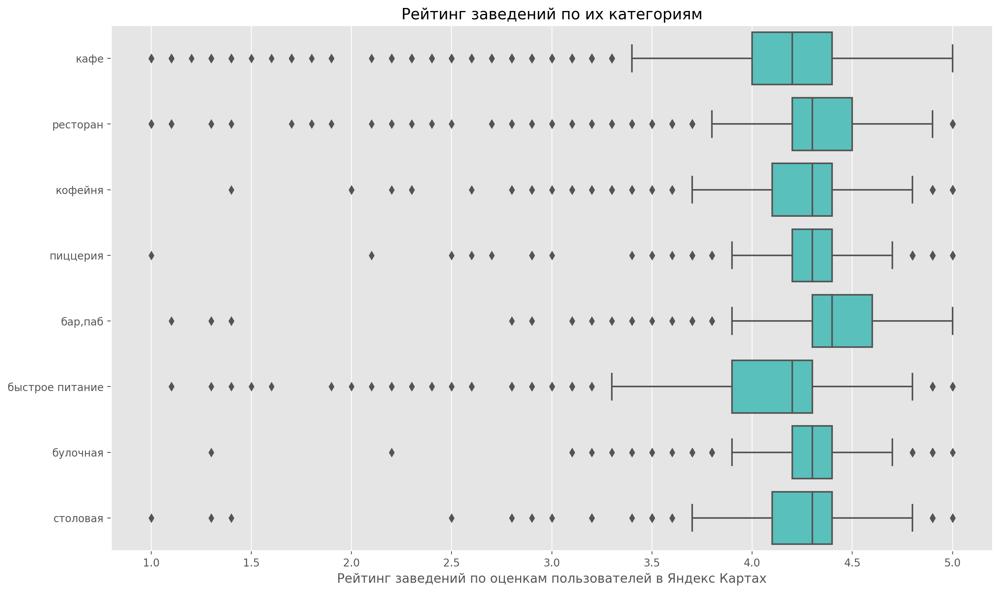

In [40]:
# диаграма размаха рейтинга заведений в разрезе их категорий
plt.figure(figsize=(15,9))
sns.boxplot(data=df, x='rating', y='category', color='mediumturquoise')
plt.title('Рейтинг заведений по их категориям')
plt.xlabel('Рейтинг заведений по оценкам пользователей в Яндекс Картах')
plt.ylabel(None);

По медианным значениям рейтинги заведений в разных типах общепита также незначительно различаются и находятся в том же диапазоне. Рейтинг баров и пабов также немного превосходит остальные категории, а минимальная оценка - у заведений быстрого питания.  

- **Фоновая картограмма (хороплет) со средним рейтингом заведений каждого района.**

Для каждого округа Москвы посчитаем средний рейтинг заведений общепита, которые находятся на его территории.

In [41]:
# средние рейтинги по каждому району
rating_df = df.groupby('district', as_index=False)['rating'].mean().sort_values(by='rating',ascending=False)
display(rating_df)

,district,rating
5,Центральный административный округ,4.377520
2,Северный административный округ,4.239822
4,Северо-Западный административный округ,4.208802
8,Южный административный округ,4.184063
1,Западный административный округ,4.180000
0,Восточный административный округ,4.174589
7,Юго-Западный административный округ,4.172419
3,Северо-Восточный административный округ,4.147978
6,Юго-Восточный административный округ,4.101120


Средний рейтинг заведений по оценкам пользователей в Яндекс Картах в разрезе административных районов Москвы также незначительно отличается. Максимальная средняя оценка объектов общепита - 4.38 в ЦАО, а минимальный средний рейтинг - 4.1 в Юго-Восточном АО Москвы.

Напишем функцию `choropleth` и отобразим фоновую картограмму (хороплет) со средним рейтингом заведений каждого района.

In [42]:
# функция для отображения хороплета
def choropleth(data, group, column, agg, title):
    rating_df = data.groupby(group, as_index=False)[column].agg(agg)
    
    # загружаем JSON-файл с границами округов Москвы (state_geo = '/datasets/admin_level_geomap.geojson')
    state_geo ='https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'
    
    # moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
    moscow_lat, moscow_lng = 55.751244, 37.618423
    
    # создаём карту Москвы
    m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
    
    # создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
    Choropleth(
        geo_data=state_geo,
        data=rating_df,
        columns=[group, column],
        key_on='feature.name',
        fill_color='YlGnBu',
        fill_opacity=0.8,
        legend_name=title,
    ).add_to(m)
    
    # выводим карту
    return m

In [43]:
# хороплет со средним рейтингом заведений каждого района.
choropleth(df, 'district', 'rating', 'mean', 'Средний рейтинг заведений по районам')

На хороплете со средним рейтингом заведений каждого района видим, что в Центральном АО средний рейтинг заведений максимальный. Также выше средний рейтинг у объектов общепита в Северном и Северо-Западном АО, а минимальный рейтинг у объектов, расположенных в Юго-Восточном АО Москвы.

- **Отображение на карте всех заведений общественного питания.**

Отобразим все заведения датасета на карте с помощью кластеров средствами библиотеки `folium`.

In [44]:
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423
# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма, создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    # сохраняем URL-адрес изображения со значком заведения общепита с icons8 (это путь к файлу на сервере icons8)
    icon_url = 'https://img.icons8.com/?size=512&id=dKwHvyBAlXHk&format=png'  
    
    # создаём объект с собственной иконкой размером 30x30
    icon = CustomIcon(icon_url, icon_size=(30, 30))
    
    # создаём маркер с иконкой icon и добавляем его в кластер
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}", icon=icon,
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
df.apply(create_clusters, axis=1)
m

Все заведения московского общепита, представленнные в данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года, отображены на карте. В `folium` для маркеров по умолчанию создаётся стандартная синяя иконка, которую мы заменили на значок заведения общепита не только из соображений дизайна, но и для удобства чтения карты.

- **Топ-15 улиц по количеству заведений.**

Выберем 15 улиц с наибольшим количеством точек общепита и построим столбчатую диаграмму распределения количества заведений по этим улицам.

In [45]:
# топ-15 улиц по количеству заведений общепита
street_top = df.groupby('street')['name'].count().sort_values(ascending=False).head(15)

# построение барчарта с распределением количества заведений по улицам
fig = px.bar(street_top.sort_values(), x=street_top.index, y=street_top, color_discrete_sequence=['mediumorchid'],
             opacity= 0.6, text=street_top)
fig.update_layout(title={'text':'Распределение количества заведений по улицам','x':0.5},
                  xaxis_title='Улица', yaxis_title='Количество заведений',
                  width=1000, height=700, legend=dict(y=0.99, x=0.7))
fig.show() 

Наибольшая концентрация точек общепита на проспекте Мира - 183 заведения. На втором месте по количеству объектов общепита Профсоюзная улица, на которой расположены 122 точки. Замыкает тройку лидеров по числу заведений Ленинский проспект, где насчитывается 107 мест общественного питания. Замыкают топ-15 Пятницкая улица и улица Миклухо-Маклая, где по 48 и 47 заведений общепита.

Также построим график распределения количества заведений и их категорий по топ-15 улицам.

In [46]:
# датафрейм для заведений, расположенных на топ-15 улицах
df_street = df.query('street in @street_top.index')
# датафрейм с количеством заведений, расположенных на топ-15 улицах в разрезе категорий 
df_15_street = df_street.groupby(['street', 'category'], as_index=False)['name'].count()

# график общего распределения количества заведений по топ-15 улицам и в разрезе категорий
fig = px.bar(df_15_street.sort_values(by='name'), x='street', y='name', color='category',
             color_discrete_sequence=colors_bar, text='name')

fig.update_layout(xaxis={'categoryorder':'total descending'}, width=1000, height=800, 
                  title={'text':'Распределение заведений по улицам и категориям','x':0.45}, 
                  xaxis_title='Улица', yaxis_title='Количество заведений', legend=dict(y=0.96, x=0.8))
fig.show() 

При исследовании категорий по улицам можем отметить те, где большая часть заведений приходится на рестораны: Ленинский и Ленинградский проспекты, проспект Вернадского, Дмитровское и Варшавское шоссе, Кутузовский проспект и Пятницкая улица. На остальных улицах больше всего кафе. На третьем месте по количеству заведений кофейни, а реже всего на топ-15 улицах встречаются булочные и столовые. На некоторых улицах их вовсе нет, к примеру, на Каширском и Варшавском шоссе, МКАДе, Люблинской улице и ул. Миклухо-Маклая нет ни одной булочной. Кроме того, на МКАДе нет пиццерий, а на улицах Вавилова, Пятницкой и Миклухо-Маклая нет столовых.

Можно также обратить внимание на длину улиц, часть из них выдают такое большое число заведений за счёт протяженности. В топе улиц много шоссе и проспектов, отличающихся значителььной протяженностью.

- **Улицы, на которых находится только один объект общепита.**

Выберем улицы с единственным объектом общепита и посмотрим, много ли таких в Москве.

In [47]:
# датафрейм с количеством заведений по улицам
street_cnt = df.groupby('street', as_index=False)['name'].count()
# датафрейм с одним заведением в разрезе улиц
street_cnt = street_cnt.query('name==1')

print('В Москве всего', len(street_cnt), 'улиц, на которых находится только один объект общепита.')

В Москве всего 458 улиц, на которых находится только один объект общепита.


Посмотрим, какие категории заведениий чаще представлены на улицах с единственным заведением. Визуализируем распределение количества заведений по категориям на улицах с единственным объектом общепита с помощью барчарта.

In [48]:
# датафрейм с этими улицами
street_1_df = df.query('street in @street_cnt.street')
# распределение категорий по количеству  единичных заведений
сat_cnt = street_1_df.category.value_counts()

# построение барчарта с распределением количества заведений по категориям на улицах с единственным объектом общепита
fig = px.bar(сat_cnt.sort_values(), x=сat_cnt.index, y=сat_cnt, color_discrete_sequence=['mediumorchid'], text=сat_cnt,\
             opacity= 0.6)
fig.update_layout(title={'text':'Распределение количества заведений по категориям','x':0.5},
                  xaxis_title='Категория заведений', yaxis_title='Количество заведений',
                  width=900, height=600, legend=dict(y=0.99, x=0.78))
fig.show() 

В целом распределение одиночных мест общепита схоже с общим распределением заведений по категориям. Больше всего одиночных кафе - 160 объектов, также распространены единичные рестораны и кофейни - по 93 и 84 объекта соответственно. Также как и в общем распределении в меньшинстве булочные - 8 объектов. Отличительным моментом является большая распространенность для столовых - 36 точек, и меньшая для пиццерий - 15 мест.

С помощью тепловой карты отобразим распределение средних рейтингов единичных заведений по категориям и административным районам Москвы.

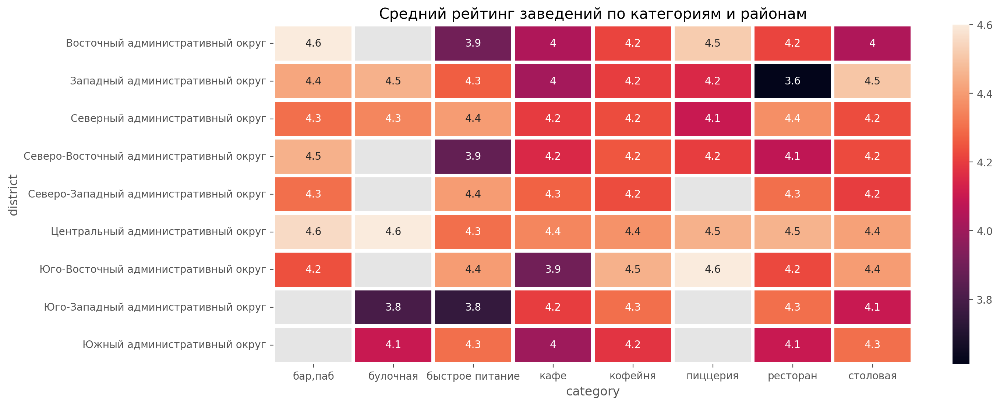

In [49]:
# тепловая карта со средним рейтингом заведений по категориям и районам
rating_street_1 = street_1_df.pivot_table(index='district', columns='category', values='rating', aggfunc='mean')
plt.figure(figsize=(14,6))
plt.title('Средний рейтинг заведений по категориям и районам')
sns.heatmap(rating_street_1, annot=True, linewidths=3);

У единственных заведений на улице достаточно высокие средние рейтинги, особенно у баров и пиццерий. Вероятно, это обусловлено отсутствием конкуренции и альтернативы для клиентов. В некоторых районах отсутствуют рейтинги определенных категорий заведений.

- **Фоновая картограмма с медианным числом оценки среднего чека каждого района.**

В столбце `middle_avg_bill` хранятся числа с оценкой среднего чека, которые указаны только для значений из столбца `avg_bill`, начинающихся с подстроки «Средний счёт». Посчитаем медиану столбца `middle_avg_bill` для каждого района.

In [50]:
# медианы числа с оценкой среднего чека по каждому району
avg_bill_median = df.groupby('district', as_index=False)['middle_avg_bill'].median() \
                  .sort_values(by='middle_avg_bill',ascending=False)
display(avg_bill_median)

,district,middle_avg_bill
1,Западный административный округ,1000.0
5,Центральный административный округ,1000.0
4,Северо-Западный административный округ,700.0
2,Северный административный округ,650.0
7,Юго-Западный административный округ,600.0
0,Восточный административный округ,550.0
3,Северо-Восточный административный округ,500.0
8,Южный административный округ,500.0
6,Юго-Восточный административный округ,450.0


Медианные значения чисел с оценкой среднего чека каждого района значительно отличаются. Максимальные медианы значений средних чеков заведений - 1000 в Западном и Центральном АО, а минимальный показатель - 450 в Юго-Восточном АО Москвы.

Используем полученные медианные значения столбца `middle_avg_bill` в качестве ценового индикатора района и построим фоновую картограмму (хороплет) с полученными значениями для каждого района.

In [51]:
# хороплет с медианными числами оценок среднего чека заведений по районам
choropleth(df, 'district', 'middle_avg_bill', 'median', 'Медианные числа с оценкой среднего чека заведений по районам')

Медианные значения оценок средних чеков заведений общепита в Центральном и Западном АО значительно превосходят другие районы, причем некоторые административные округа в два раза. В Северном и Северо-Западном округах цены в заведениях общепита также выше, а дешевле всего подкрепиться можно в Северо-Восточном, Южном и Юго-Восточном АО. Можем отметить, что удалённость от центра влияет на цены в заведениях, кроме Западного округа.

**Вывод:**

- В топ-3 по количеству объектов общественного питания входят: кафе, рестораны и кофейни, на долю которых приходятся 28 %, 24 % и 17 % заведений московского общепита. Меньше всего столовых и булочных, составляющих 3-4 % от всех объектов.

- Наименьшее количество посадочных мест в булочных и пиццериях - 50 и 54 по медианным показателям. Немногим больше в кафе и заведениях быстрого питания - 60 и 65 посадочных мест. В столовых, кофейнях и барах могут расположиться от 75 до 80 клиентов. И наиболее вместительными являются рестораны, где резмещаются порядка 86 гостей.

- Порядка 62 % заведений московского общепита не являются сетевыми, соответсвенно 38 % работают по сети. Несетевые общепиты чаще всего представлены ресторанами и кафе, также значительная доля приходится на бары и кофейни. Значительная часть сетевых заведений приходится на кофейни, рестораны и кафе. В каждом из сегментов реже встречаются заведения быстрого питания и пиццерии и в меньшинстве столовые и булочные. Кофейни, пиццерии и булочные чаще бывают сетевыми, чего не сказать о кафе, ресторанах, заведениях быстрого питания, барах и столовых.

- Самая многочисленная сеть - «Шоколадница» - 118 кофеен в Москве. Также широко распространены пиццерии «Домино'с пицца», «ДоДо пицца» и кофейни «One price coffee», «Cofix». «Яндекс лавка» имеет 68 точек и занимает 5-е место в рейтинге популярных сетей московского общепита.

- Почти 27% заведений московского общепита сосредоточено в Центральном АО - 2242 объекта. В других административных округах от 8,5% до 11% объектов - 700-900 точек общественного питания. Около 5% заведений объектов в Северо-Западном АО - 409 заведений.
Большая часть ресторанов сосредоточена в Центральном АО, в остальных районах наиболее популярны кафе. Также в них много ресторанов и кофеен. В разрезе по районам булочные и столовые также менее распространены. В целом распределение категорий заведений по районам (без учета ЦАО) схожее. В ЦАО в отличие от других районов довольно популярны пабы и бары.

- Средние рейтинги заведений по оценкам пользователей в Яндекс Картах в разных типах общепита незначительно отличаются, они находятся в диапазоне от 4.05 - у заведений быстрого питания до 4.39 - у баров и пабов. На втором и третьем местах по средним оценкам пользователей - пиццерии и рестораны.

- Средний рейтинг заведений в разрезе административных районов Москвы также незначительно отличается. Максимальная средняя оценка объектов общепита - 4.38 в Центральном АО, также высокий средний рейтинг у заведений в Северном и Северо-Западном АО, а минимальный средний рейтинг - 4.1 в Юго-Восточном АО Москвы.

- Наибольшая концентрация точек общепита на проспекте Мира - 183 заведения. На втором месте по количеству объектов общепита Профсоюзная улица - 122 точки. Замыкает тройку лидеров по числу заведений Ленинский проспект, где насчитывается 107 мест общественного питания. Чаще всего на улицах с многочисленным количеством мест общепита открываются кафе и рестораны.

- В Москве 458 улиц, на которых находится только один объект общепита. В целом распределение одиночных мест общепита схоже с общим распределением заведений по категориям. Больше всего одиночных кафе - 160 объектов, также распространены единичные рестораны и кофейни - по 93 и 84 объекта, в меньшинстве булочные - 8 объектов. Отличительным моментом является большая распространенность для столовых - 36 точек, и меньшая для пиццерий - 15 мест. Неудивительно, что у единственных заведений на улице достаточно высокие средние рейтинги, особенно выделяются бары и пиццерии.

- Максимальные медианные значения оценок средних чеков заведений общепита в Центральном и Западном АО равны 1000 и значительно превосходят другие районы, причем некоторые административные округа в два раза. В Северном и Северо-Западном округах цены в заведениях общепита также выше, а дешевле всего подкрепиться можно в Северо-Восточном, Южном и Юго-Восточном АО. Удалённость от центра влияет на цены в заведениях, кроме Западного округа.

## Детализация исследования: открытие кофейни.

- **Распределение кофеен по административным районам Москвы.**

Ранее мы определили, что кофейни составляют 17 % московского общепита. Узнаем, сколько всего кофеен в Москве.

In [52]:
# датафрейм с кофейнями
coffee_df = df.query('category=="кофейня"')
print('В москве', len(coffee_df), 'кофейня.')

В москве 1408 кофейня.


Рассмотрим их распределение по административным районам. Визуализируем распределение кофеен по административным районам с помощью барчарта и круговой диаграммы.

In [53]:
# распределение кофеен по районам 
coffe_distr = coffee_df.groupby('district')['name'].count().sort_values(ascending=False)

# построение барчарта с распределением количества заведений по категориям на улицах с единственным объектом общепита
fig = px.bar(coffe_distr.sort_values(), x=coffe_distr.index, y=coffe_distr,
             color_discrete_sequence=['mediumorchid'], opacity= 0.6, text=coffe_distr)
fig.update_layout(title={'text':'Распределение кофеен по административным районам Москвы','x':0.5},
                  xaxis_title='Административный район', yaxis_title='Количество заведений',
                  width=1000, height=700, legend=dict(y=0.98, x=0.52))
fig.show() 

In [54]:
# построение круговой диаграммы соотношения количества кофеен по районам
fig = go.Figure(data=[go.Pie(labels=coffe_distr.index, values=coffe_distr, marker={'colors':colors})])
fig.update_layout(title={'text':'Соотношение количества кофеен по административным районам Москвы','x':0.5}) 
fig.show()

Большая часть кофеен - 30.5 % расположена в Центральном АО, в нем открыты 428 точки. 13 % заведений в Северном АО и чуть меньше в Северо-Восточном и Западном округах - по 11 % и 10 % соответственно. Наименьшее количество объектов в Северо-Западном округе, всего 62 заведения или 4 % от общего числа кофеен.

Отобразим все кофейни на карте Москвы для рассмотрения особенностей их расположения.

In [55]:
# отображение кофеен на карте
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
marker_cluster = MarkerCluster().add_to(m)
coffee_df.apply(create_clusters, axis=1)
m

- **Исследование круглосуточных кофеен.**

Проверим, есть ли в Москве круглосуточные кофейни.

In [56]:
print(f"В Москве {coffee_df['is_24/7'].sum()} круглосуточных кофеен.")

В Москве 59 круглосуточных кофеен.


Так как заведений немного, видимо, круглосуточность не такой популярный формат для кофеен. Все-таки легче представить человека, который ночью захочет воспользоваться баром, а не посетить кофейню.

Ознакомимся с распределением круглосуточных кофеен по административным районам Москвы и отобразим соотношение количества круглосуточных кофеен по районам.

In [57]:
# датафрейм с круглосуточными кофейнями
coffe_24 = coffee_df[coffee_df['is_24/7']==True]
# распределение круглосуточных кофеен по районам
coffe_24_distr = coffe_24.groupby('district')['name'].count().sort_values(ascending=False)
print(coffe_24_distr)

district
Центральный административный округ         26
Западный административный округ            9 
Юго-Западный административный округ        7 
Восточный административный округ           5 
Северный административный округ            5 
Северо-Восточный административный округ    3 
Северо-Западный административный округ     2 
Юго-Восточный административный округ       1 
Южный административный округ               1 
Name: name, dtype: int64


In [58]:
# построение круговой диаграммы соотношения количества кофеен по районам
fig = go.Figure(data=[go.Pie(labels=coffe_24_distr.index, values=coffe_24_distr, marker={'colors':colors})])
fig.update_layout(title={'text':'Соотношение количества круглосуточных кофеен по административным районам Москвы','x':0.45}) 
fig.show()

Подавляющее большинство - 44 % круглосуточных кофеен или 26 точек находятся в Центральном округе, 15 % распложены в Западном АО. 7 кофеен или 12 % открыты в Юго-Западном округе. В Восточном и Северном АО по 5 круглосуточных заведений. 5 % или 3 точки в Северо-Восточном округе и 2 кофейни в Северо-Западном АО. По одной круглосуточной кофейне в Юго-Восточном и Южном округах.

- **Распределение средних рейтингов кофеен по административным районам.**

Для каждого округа Москвы посчитаем средний рейтинг кофеен, которые находятся на его территории.

In [59]:
# средние рейтинги кофеен по каждому району
coffe_rating = coffee_df.groupby('district', as_index=False)['rating'].mean().sort_values(by='rating',ascending=False)
display(coffe_rating)

,district,rating
5,Центральный административный округ,4.336449
4,Северо-Западный административный округ,4.325806
2,Северный административный округ,4.291710
0,Восточный административный округ,4.284615
7,Юго-Западный административный округ,4.283333
8,Южный административный округ,4.232824
6,Юго-Восточный административный округ,4.225843
3,Северо-Восточный административный округ,4.216981
1,Западный административный округ,4.193151


Средний рейтинг кофеен по оценкам пользователей в Яндекс Картах в разрезе административных районов Москвы незначительно отличается. Максимальная средняя оценка - 4.34 в ЦАО, а минимальный средний рейтинг - 4.19 в Западном округе Москвы.

Построим фоновую картограмму (хороплет) со средним рейтингом кофеен каждого района.

In [60]:
# хороплет со средним рейтингом кофеен по районам
choropleth(coffee_df, 'district', 'rating', 'mean', 'Средний рейтинг кофеен по районам')

Выше средний рейтинг у кофеен в Центральном и Северо-Западном округах. Чуть ниже средний рейтинг у точек в Северном, Восточном и Юго-Западном районах. Минимальный средний рейтинг в Северо-Восточном и Западном АО.

На какую стоимость чашки капучино стоит ориентироваться при открытии и почему?

- **Фоновая картограмма с медианным числом оценки одной чашки капучино каждого района.**

В столбце `middle_coffee_cup` хранятся числа с оценкой одной чашки капучино, которое указано только для значений из столбца `avg_bill`, начинающихся с подстроки «Цена одной чашки капучино». Посчитаем медиану столбца `middle_coffee_cup` в целом для Москвы и для каждого административного района.

In [61]:
print('Медианная стоимость одной чашки капучино в Москве', coffee_df['middle_coffee_cup'].median(), 'рублей.')

# медианы числа с оценкой одной чашки капучино по каждому району
coffee_cup_median = coffee_df.groupby('district', as_index=False)['middle_coffee_cup'].median() \
                  .sort_values(by='middle_coffee_cup',ascending=False)
display(coffee_cup_median)

Медианная стоимость одной чашки капучино в Москве 169.5 рублей.


,district,middle_coffee_cup
7,Юго-Западный административный округ,198.0
5,Центральный административный округ,190.0
1,Западный административный округ,187.0
4,Северо-Западный административный округ,165.0
3,Северо-Восточный административный округ,162.5
2,Северный административный округ,159.0
8,Южный административный округ,150.0
6,Юго-Восточный административный округ,147.5
0,Восточный административный округ,135.0


В трех районах - Юго-Западном, Центральном и Западном АО стоимость чашки капучино выше медианной стоимости по Москве. Медианные значения чисел с оценкой одной чашки капучино каждого района отличаются. Максимальная стоимость чашки капучино 198 рублей в Юго-Западном округе. А минимальный показатель - 135 рублей в Восточном АО Москвы.

Используем полученные медианные значения столбца `middle_coffee_cup` в качестве ценового индикатора района и построим фоновую картограмму (хороплет) с полученными значениями для каждого района.

In [62]:
# хороплет с медианными числами оценок одной чашки капучино в кофейнях по районам
choropleth(coffee_df, 'district', 'middle_coffee_cup', 'median', \
           'Медианные числа с оценкой одной чашки капучино в кофейнях по районам')

Максимальная стоимость чашки капучино в Юго-Западном и Центральном округах, 198 и 190 рублей. Также привлекательный ценник в Западном окуруге - 187 рублей. В Северном, Северо-Восточном и Северо-Западном АО чашка капучино стоит от 159 до 165 рублей по медианной оценке. Дешевле всего можно купить капучино в Восточном округе, где медианное число с оценкой одной чашки капучино равно 135.

**Вывод:**

На начальном этапе детализации исследования посчитали, что в Москве 1 401 кофейня. Отобразили распределение кофеен по административным районам с помощью барчарта и круговой диаграммы и отметили, что большая часть кофеен - 30.5 % расположена в Центральном АО (428 точки). 13% заведений в Северном АО и чуть меньше в Северо-Восточном и Западном округах - по 11 % и 10 % соответственно. Наименьшее количество объектов в Северо-Западном округе, всего 62 заведения или 4 % от общего числа кофеен.

Во время исследования режима работы кофеен выявили, что 59 из них работают круглосуточно. Подавляющее большинство - 44 % круглосуточных кофеен (26 точек) находятся в Центральном округе, 15 % распложены в Западном АО. 7 кофеен или 12 % открыты в Юго-Западном округе. В Восточном и Северном АО по 5 круглосуточных заведений. 5 % (3 точки) в Северо-Восточном округе и 2 кофейни в Северо-Западном АО. По одной круглосуточной кофейне в Юго-Восточном и Южном округах.

Изучив распределение средних рейтингов кофеен по районам, узнали, что средний рейтинг кофеен в различных административных районах Москвы незначительно отличается. Выше средний рейтинг у кофеен в Центральном(4.34) и Северо-Западном округах. Чуть ниже средний рейтинг у точек в Северном, Восточном и Юго-Западном районах. Минимальный средний рейтинг в Северо-Восточном и Западном АО(4.19).

Посчитали медианную стоимость чашки капучино в Москве - 170 рублей. Построили фоновую картограмму с медианным числом оценки одной чашки капучино для каждого района и узнали, что максимальная стоимость чашки капучино в Юго-Западном и Центральном округах, 198 и 190 рублей. Также привлекательный ценник в Западном округе - 187 рублей. В Северном, Северо-Восточном и Северо-Западном АО чашка капучино стоит от 159 до 165 рублей по медианной оценке. Дешевле всего можно купить капучино в Восточном округе, где медианное число с оценкой одной чашки капучино равно 135.

**Рекомендации основателям фонда «Shut Up and Take My Money» для открытия нового заведения:**

При открытии кофейни имеет смысл ориентироваться на медианную стоимость чашки капучино в Москве - 170 рублей, данный ценник позволит быть конкурентоспособными, т.к. такая стоимость не относится ни к низкому, ни к высокому ценовому сегменту.

В качестве перспективных районов для кофейни можно рассмотреть Центральный и Юго-Западный округи с максимальной стоимостью чашки капучино. Это позволит немного снизить цену на старте продаж без существенных потерь для привлечения клиентов. При выборе этих районов мы также руководствовались высоким средним рейтингом кофеен, именно поэтому не можем рекомендовать Западный АО с низикими рейтингами заведений, несмотря на высокую стоимость чашки капучино. Центральный район несмотря на сильную конкуренцию обеспечивает максимальный и постоянный человекопоток, но стоит учитывать, что в нем будет и высокая стоимость аренды. В Юго-Западном округе конкуренция значительно ниже, в нем всего около 7% всех кофеен, а расходы на аренду или покупку недвижимости будут поскромнее, нежели в центре.

Дополнительно к названным районам, можем рекомендовать Северо-Западный округ Москвы, т.к. город расширяется и застраивается в этом направлении. Конкуренция для кофейни в нем минимальная, всего 62 точки в районе, но при этом рейтинг заведений общепита и в частности кофеен высокий.

При выборе улицы стоит присмотреться к тем, где минимальное количество объектов общественного питания, следовательно низкая конкуренция, и напротив, улицы из списка топ-15, обеспечивающие максимальную проходимость потенциальных клиентов.

Резюмируя, в процессе выбора оптимальной локации для нового заведения следует обратить внимание на соотношение проходимости, стоимости аренды и стоимости кофе, чтобы рассчитать, где и как экономика будет сходиться.

## Общий вывод.

Проводя исследовательскую работу по анализу рынка заведений общественного питания Москвы изучили и подготовили данные к анализу. Были обнаружены, но не обработаны пропущенные значения в силу отсутствия логической замены для них. Также на этапе предобработки данных с учетом незначительных потерь отфильтровали заведения с аномально большим количеством посадочных мест и дополнили исходный датасет новыми столбцами. На этапе иследовательскиого анализа данных рассмотрели и визуализировали с помощью барчартов и пайчартов распределения: заведений, посадочных мест по категориям, соотношение сетевых и несетевых заведений и их распределение по категориям. Выделили 15 популярных сетей в Москве и рассмотрели распределения: заведений по районам и категориям, средних рейтингов по категориям заведений. Отобразили фоновые картограммы со средним рейтингом заведений и с медианным числом оценки среднего чека каждого района. Выделили топ-15 улиц по количеству заведений и напротив, улицы с единичным объектом. На этапе детализации исследования в разрезе кофеен рассмотрели распределение кофеен по административным районам Москвы и изучили круглосуточные кофейни. Также построили хороплеты со средним рейтингом кофеен и с медианным числом оценки одной чашки капучино каждого района. На основе полученных результатов дали рекомендацию заказчикам для открытия нового заведения.

В процессе исследования данных пришли к следующим выводам:

- **исследовательский анализ:**

В данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года представлены 8 403 заведения московского общепита. В топ-3 по количеству объектов общественного питания входят: кафе, рестораны и кофейни, на долю которых приходятся 28 %, 24 % и 17 % заведений московского общепита. Меньше всего столовых и булочных, составляющих 3-4 % от всех объектов.

По количеству посадочных мест наиболее вместительны рестораны, где размещаются порядка 86 гостей. 75-80 гостей вмещают столовые, кофейни и бары. В кафе и заведениях быстрого питания по 60 и 65 посадочных мест. Менее вместительны булочные и пиццерии - 50 и 54 места по медианным показателям.

38 % заведений московского общепита работают по сети. Из них значительная часть приходится на кофейни, рестораны и кафе. Реже встречаются бары, заведения быстрого питания и пиццерии, меньше всего - столовых и булочных. Кофейни, пиццерии и булочные чаще бывают сетевыми. Самая многочисленная сеть - «Шоколадница» - 118 кофеен в Москве. Также широко распространены пиццерии «Домино'с пицца», «ДоДо пицца» и кофейни «One price coffee», «Cofix».

Почти 27% заведений московского общепита сосредоточено в Центральном АО - 2242 объекта. В других административных округах от 8,5% до 11% объектов - 700-900 точек общественного питания. Около 5% заведений объектов в Северо-Западном АО - 409 заведений. Большая часть ресторанов сосредоточена в Центральном АО, в остальных районах наиболее популярны кафе. Также в них много ресторанов и кофеен. В разрезе по районам булочные и столовые также менее распространены. Также В ЦАО в отличие от других районов довольно популярны пабы и бары.

Средние рейтинги заведений по оценкам пользователей в Яндекс Картах в разных типах общепита незначительно отличаются, они находятся в диапазоне от 4.05 - у заведений быстрого питания до 4.39 - у баров и пабов. На втором и третьем местах по средним оценкам пользователей - пиццерии и рестораны. Средний рейтинг заведений в разрезе административных районов Москвы также незначительно отличается. Максимальная средняя оценка объектов общепита - 4.38 в Центральном АО, также высокий средний рейтинг у заведений в Северном и Северо-Западном АО, а минимальный средний рейтинг - 4.1 в Юго-Восточном округе Москвы.

Максимальная концентрация точек общепита на проспекте Мира - 183 заведения. На втором месте Профсоюзная улица - 122 точки. Замыкает тройку лидеров Ленинский проспект - 107 объектов. Чаще всего на улицах с многочисленным количеством мест общепита открываются кафе и рестораны. В Москве 458 улиц с единственным объектом общепита. Больше всего одиночных кафе, также распространены единичные рестораны и кофейни, в меньшинстве булочные. Отличительным моментом в сравнении с общим распределением заведений по категорям является большая распространенность для столовых, и меньшая для пиццерий. У единственных заведений на улице достаточно высокие средние рейтинги, особенно выделяются бары и пиццерии.

Максимальные медианные значения оценок средних чеков заведений общепита в Центральном и Западном АО равны 1000 и значительно превосходят другие районы, причем некоторые административные округа в два раза. В Северном и Северо-Западном округах цены в заведениях общепита также выше, а ниже средний чек в Северо-Восточном, Южном и Юго-Восточном АО. Удалённость от центра влияет на цены в заведениях, кроме Западного округа.

- **детализация исследования: открытие кофейни**

Всего в Москве 1 401 кофейня. Их большая часть - 30.5 % или 428 кофейни расположены в Центральном АО. 13% заведений в Северном АО и чуть меньше в Северо-Восточном и Западном округах - по 11 % и 10 % соответственно. Наименьшее количество объектов в Северо-Западном округе, всего 62 заведения или 4 % от общего числа кофеен.

59 кофеен работают круглосуточно. Из них 44 % или 26 точек находятся в Центральном округе, 15 % распложены в Западном АО. 7 кофеен или 12 % открыты в Юго-Западном округе. В Восточном и Северном АО по 5 круглосуточных заведений. 5 %  или 3 кофейни в Северо-Восточном округе и 2 в Северо-Западном АО. По одной круглосуточной кофейне в Юго-Восточном и Южном округах.

Средний рейтинг кофеен в различных административных районах Москвы незначительно отличается. Выше средний рейтинг у кофеен в Центральном(4.34) и Северо-Западном округах. Чуть ниже средний рейтинг у точек в Северном, Восточном и Юго-Западном районах. Минимальный средний рейтинг в Северо-Восточном и Западном АО(4.19).

Максимальная стоимость чашки капучино в Юго-Западном и Центральном округах, 198 и 190 рублей. Также высокий ценник в Западном окуруге - 187 рублей. В Северном, Северо-Восточном и Северо-Западном АО чашка капучино стоит от 159 до 165 рублей по медианной оценке. Дешевле всего можно купить капучино в Восточном округе - 135 рублей.

- **рекомендации:**

Основатели фонда сделали хорошую ставку при выборе в качестве заведения кофейни. Данная категория московского общепита входит в тройку самых популярных, следовательно на рынке высокий спрос, и в то же время у кофеен конкуренция значительно ниже, чем у кафе и ресторанов. Кроме того, у данной категории высокий средний рейтинг заведений по оценкам пользователей в Яндекс Картах.

При открытии кофейни предлагаем ориентироваться на медианную стоимость чашки капучино в Москве - 170 рублей, такая стоимость относится к среднему ценовому сегменту и позволит оставаться конкурентоспособными на рынке общепита. 

В качестве перспективных районов для кофейни можно рассмотреть Центральный и Юго-Западный округи с максимальной стоимостью чашки капучино. Это позволит немного снизить цену на старте продаж без существенных потерь для привлечения клиентов. При выборе этих районов мы также руководствовались высоким средним рейтингом кофеен, именно поэтому не можем рекомендовать Западный АО с низикими рейтингами заведений, несмотря на высокую стоимость чашки капучино. Центральный район несмотря на сильную конкуренцию обеспечивает максимальный и постоянный человекопоток, но стоит учитывать, что в нем будет и высокая стоимость аренды. В Юго-Западном округе конкуренция значительно ниже, в нем всего около 7% всех кофеен, а расходы на аренду или покупку недвижимости будут поскромнее, нежели в центре.

Дополнительно к названным районам, можем рекомендовать Северо-Западный округ Москвы, т.к. город расширяется и застраивается в этом направлении. Конкуренция для кофейни в нем минимальная, всего 62 точки в районе, но при этом рейтинг заведений общепита и в частности кофеен высокий. Кроме того, постоянные затраты будут ниже, чем в Центральном округе. 

При выборе улицы стоит присмотреться к тем, где минимальное количество объектов общественного питания, следовательно низкая конкуренция, и напротив, улицы из списка топ-15, обеспечивающие максимальную проходимость потенциальных клиентов.

-------------------------------------------------------------------------------------------------------------------------------
**Презентация:** <https://disk.yandex.ru/i/dDY74dLzhMKyUA> 